In [1]:
# This is a medical data set, in which we have to classify cancer. 
# First we need to visualize the data and perform feature selection and feature engineering.
# This note book uses a python virtual environmet saved i my local pc.
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import time
from subprocess import check_output
import warnings
# ignore all warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv("Medical_cancer_data.csv")

In [3]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [4]:
df.shape

(569, 33)

In [5]:
col = df.columns
col

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [6]:
# in this data we dot need "id", 'Unnamed: 32'. So we dot eed these. But lets check how may NaN values in the 'Unnamed: 32' column?
# the 'Unnamed: 32' column has NaN values oly. so we can drop it
df['Unnamed: 32'].isna().sum()


569

In [7]:
#we can assign our Y value, since Y is our target feature. So the 'diagnosis' column is our target variable
y = df['diagnosis']

In [8]:
y  #so our y data contains either M - Malignant or B - Benign

0      M
1      M
2      M
3      M
4      M
      ..
564    M
565    M
566    M
567    M
568    B
Name: diagnosis, Length: 569, dtype: object

In [9]:
#Lets drop the other 3 columns we discussed before
list = ['Unnamed: 32','id','diagnosis']
x = df.drop(list,axis = 1 )
x.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


number of Malignant: 212
number of benign: 357


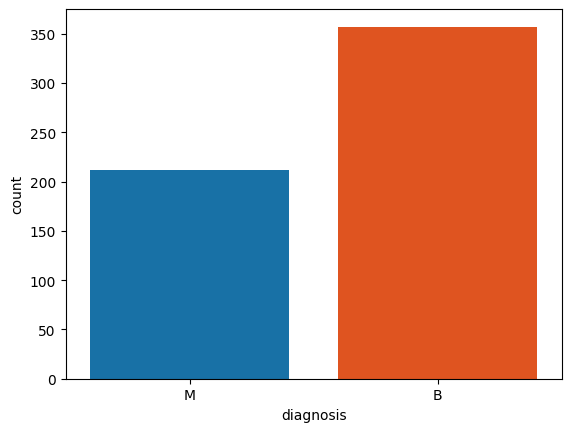

In [10]:
#Lets plot the target feature
sns.countplot(x = 'diagnosis', data = df, label = "diagnosis_count", palette=['#0077be', '#ff4500'])
B , M = y.value_counts()
print('number of Malignant:', M)
print('number of benign:', B)

In [11]:
# now that we have the predictor and the target variable set, 
# lets now understand how these predictor variables contribute towards predicting the target.
x.describe()  #Descriptive stats

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [12]:
# We need to bring the data to a common scale. 
# Lets standardize the data

In [13]:
x.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [14]:
from sklearn.preprocessing import StandardScaler

In [15]:
# Initialize the StandardScaler
scaler = StandardScaler()

In [16]:
# Fit and transform the data
scaled_data = scaler.fit_transform(x)

In [17]:
df_std = pd.DataFrame(scaled_data, columns=x.columns)
df_std

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,1.901185,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,1.536720,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,0.561361,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,1.961239,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635


In [18]:
# Let's concat our output with input features.
data_melt = pd.concat([df_std, y], axis=1)
data_melt

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,diagnosis
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015,M
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190,M
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391,M
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010,M
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091,M
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978,M
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409,M
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635,M


In [19]:
#Lets melt the data for the violin plot
data_melt = pd.melt(data_melt,id_vars="diagnosis",
                    var_name="features",
                    value_name='value')

In [20]:
data_melt

,diagnosis,features,value
0,M,radius_mean,1.097064
1,M,radius_mean,1.829821
2,M,radius_mean,1.579888
3,M,radius_mean,-0.768909
4,M,radius_mean,1.750297
...,...,...,...
17065,M,fractal_dimension_worst,-0.709091
17066,M,fractal_dimension_worst,-0.973978
17067,M,fractal_dimension_worst,-0.318409
17068,M,fractal_dimension_worst,2.219635


([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29],
 [Text(0, 0, 'radius_mean'),
  Text(1, 0, 'texture_mean'),
  Text(2, 0, 'perimeter_mean'),
  Text(3, 0, 'area_mean'),
  Text(4, 0, 'smoothness_mean'),
  Text(5, 0, 'compactness_mean'),
  Text(6, 0, 'concavity_mean'),
  Text(7, 0, 'concave points_mean'),
  Text(8, 0, 'symmetry_mean'),
  Text(9, 0, 'fractal_dimension_mean'),
  Text(10, 0, 'radius_se'),
  Text(11, 0, 'texture_se'),
  Text(12, 0, 'perimeter_se'),
  Text(13, 0, 'area_se'),
  Text(14, 0, 'smoothness_se'),
  Text(15, 0, 'compactness_se'),
  Text(16, 0, 'concavity_se'),
  Text(17, 0, 'concave points_se'),
  Text(18, 0, 'symmetry_se'),
  Text(19, 0, 'fractal_dimension_se'),
  Text(20, 0, 'radius_worst'),
  Text(21, 0, 'texture_worst'),
  Text(22, 0, 'perimeter_worst'),
  Text(23, 0, 'area_worst'),
  Text(24, 0, 'smoothness_worst'),
  Text(25, 0, 'compactness_w

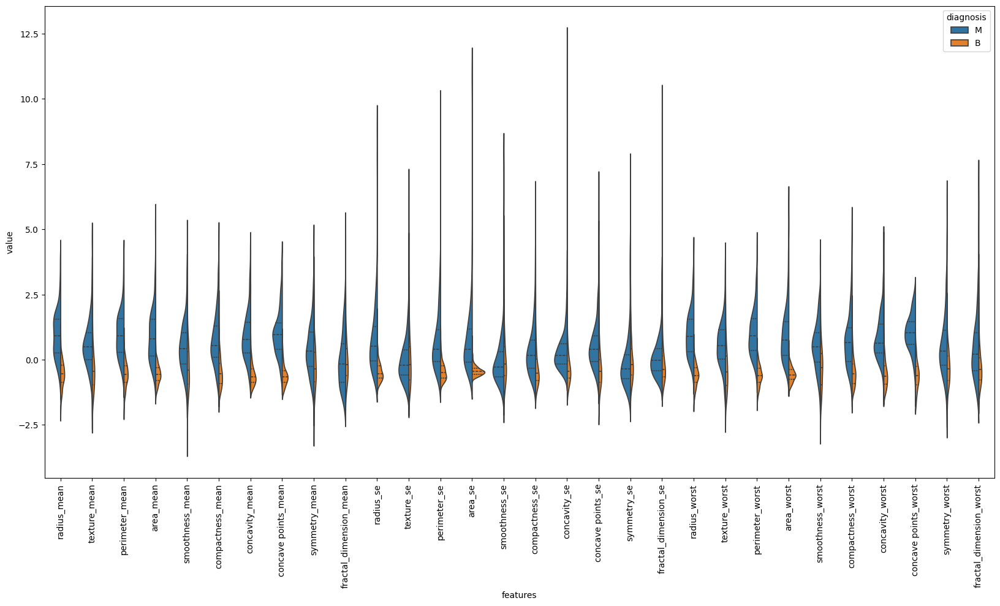

In [21]:
plt.figure(figsize=(20,10))
sns.violinplot(x="features", y="value", hue="diagnosis", data=data_melt,split=True, inner="quart")
plt.xticks(rotation=90)



In [22]:
import plotly.express as px

In [23]:
fig = px.violin(data_melt, x="features", y="value", color="diagnosis")
#fig.update_traces(side="positive", width=0.5)
#fig.update_layout(xaxis_title='Features', yaxis_title='Value', title='Violin Plot',violingap = 0.5, violinmode="overlay")
fig.show()

In [24]:
#Features with distinct median and spread and minimal overlap are typically more valuable for classification, leading to better model performace.
#A significant difference in medians suggests that the feature can help distinguish between classes. For instance, if area_mean values are generally 
# higher in malignant cases (M) than in benign cases (B), this feature can be a strong predictor.

For example, in texture_mean there is a significant difference between the medians of Malignant and Benign. 
So this will be a good feature for classification. However, in fractal_dimension_mean, the medians of M  and  B are almost the same.

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29],
 [Text(0, 0, 'radius_mean'),
  Text(1, 0, 'texture_mean'),
  Text(2, 0, 'perimeter_mean'),
  Text(3, 0, 'area_mean'),
  Text(4, 0, 'smoothness_mean'),
  Text(5, 0, 'compactness_mean'),
  Text(6, 0, 'concavity_mean'),
  Text(7, 0, 'concave points_mean'),
  Text(8, 0, 'symmetry_mean'),
  Text(9, 0, 'fractal_dimension_mean'),
  Text(10, 0, 'radius_se'),
  Text(11, 0, 'texture_se'),
  Text(12, 0, 'perimeter_se'),
  Text(13, 0, 'area_se'),
  Text(14, 0, 'smoothness_se'),
  Text(15, 0, 'compactness_se'),
  Text(16, 0, 'concavity_se'),
  Text(17, 0, 'concave points_se'),
  Text(18, 0, 'symmetry_se'),
  Text(19, 0, 'fractal_dimension_se'),
  Text(20, 0, 'radius_worst'),
  Text(21, 0, 'texture_worst'),
  Text(22, 0, 'perimeter_worst'),
  Text(23, 0, 'area_worst'),
  Text(24, 0, 'smoothness_worst'),
  Text(25, 0, 'compactness_w

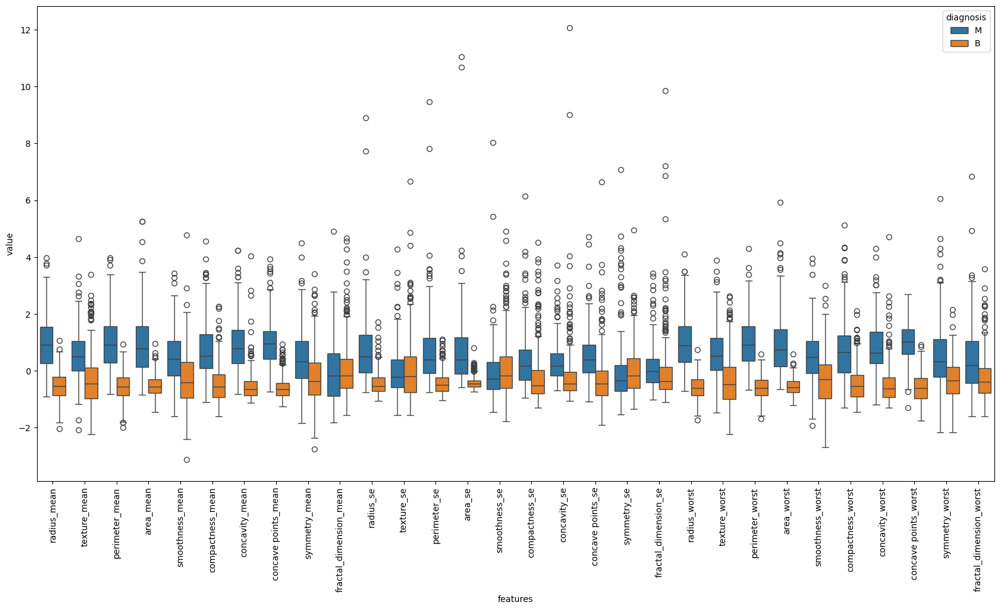

In [25]:
#Lets do some box plots.
plt.figure(figsize=(20,10))
sns.boxplot(x="features", y="value", hue="diagnosis", data=data_melt)
plt.xticks(rotation=90)

variability of features such as symmetry_worst and fractal_dimension_worst looks kind of similar. but we need to check for correlation between them. 
Multicolinearity among features can lead to redundancy and over fitting  issues. redundancy leads to the ml model becoming more complex without improving performance.
Because the features that have multi colinearity with another feature will have very negligible contributions to the overall model performance.

for example: to check the multi colinearity among the above mentioned 2 features lets check the colinearity among them.
Lets do a join plot.


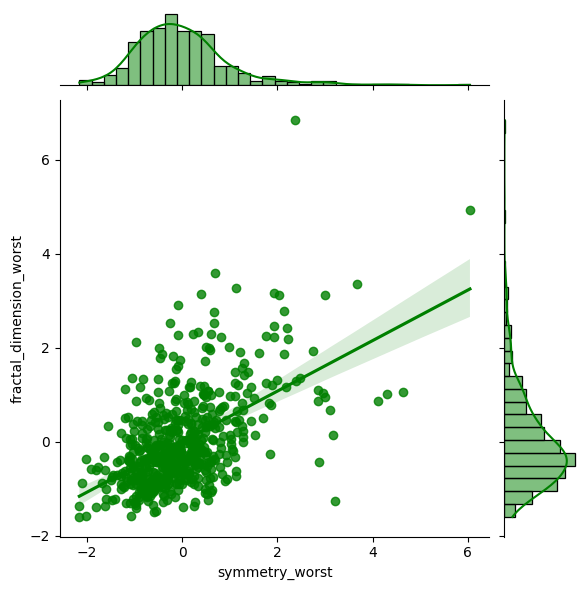

In [26]:
sns.jointplot(x='symmetry_worst',y='fractal_dimension_worst',data=df_std,kind = "reg", color = "Green")

In [27]:
#Lets check the correlation among these two features
corr = df_std["symmetry_worst"].corr(df_std['fractal_dimension_worst'])
corr

0.5378482062536086

In [28]:
# There is not a very strong correlation, so we can keep the above two features for further consideration
# Lets check two more features
corr = df_std["concavity_worst"].corr(df_std['concave points_worst'])
corr

0.8554338603439996

In [29]:
# to check other correlations we can use a pair plot
sns.pairplot(df_std)

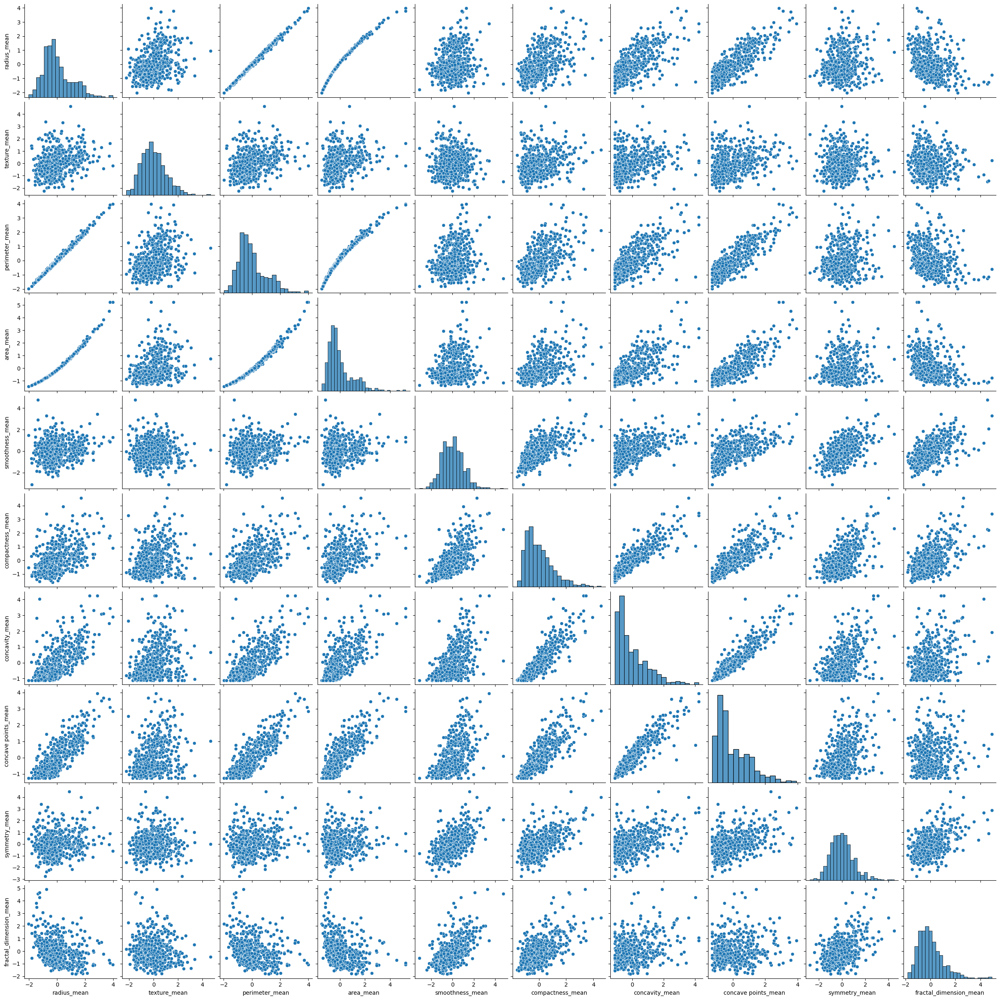

In [30]:
# The above pair plot is too much to compile. Lets take 10 features at a time and try to interpret them.

sns.pairplot(df_std.iloc[:,:10])

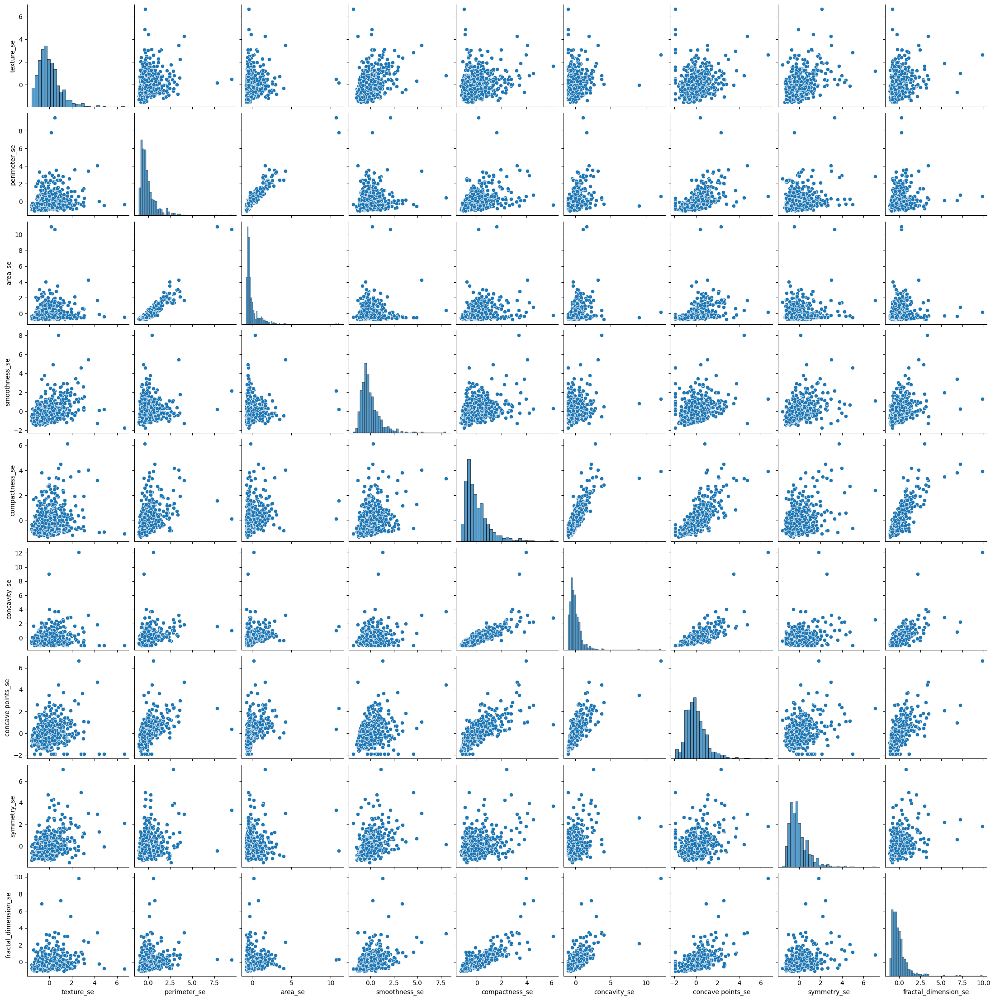

In [31]:
# Here we can see high correlation among radius_mean and Perimeter_mean / radius_mean and Area mean / perimetermean ad area mean / concavity mean and concave_poins_mean. 
# So in our final model we need to look for such relationships and include one feature in the final model build.
# Lets look at the next 10 features in a pair plot

sns.pairplot(df_std.iloc[:,11:20])



Here perimeter_se and area_se are highly correlated. also, seems like concavity_se is highly corelated with compactness_se


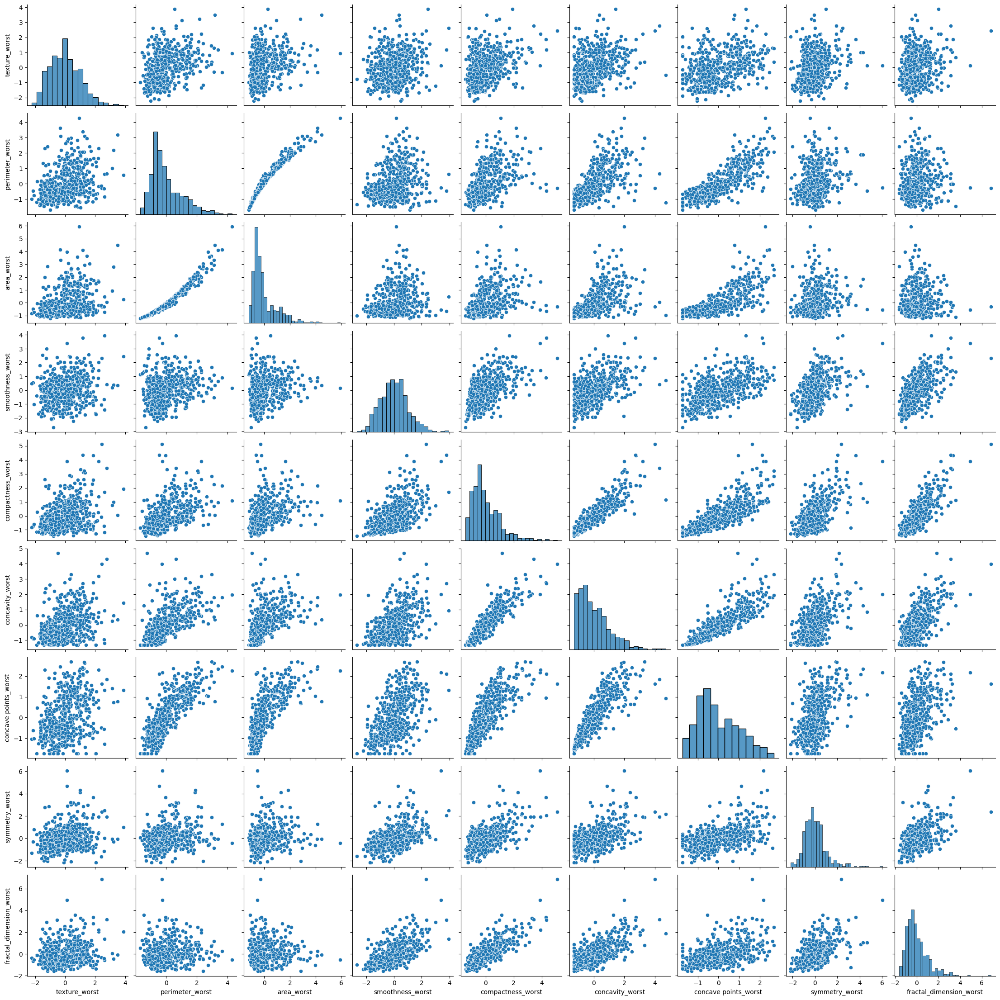

In [32]:
# Lets look at the last 10 features
sns.pairplot(df_std.iloc[:,21:])

Now that we have some basic idea about the features and correlations among them. To understand these features better lets build some swarm plots to see which features would be the most suitable for classification models.

In [33]:
df_std

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,1.901185,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,1.536720,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,0.561361,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,1.961239,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635


In [34]:
df.shape

(569, 33)

In [35]:
#Lets apply standard scaler to our original dataframe df
scaler = StandardScaler()
x_new=df.drop(list, axis=1)
y_new=df['diagnosis']
x_scaled = scaler.fit_transform(x_new)

In [36]:
y_new = pd.DataFrame(y_new, columns=['diagnosis'])
y_new

,diagnosis
0,M
1,M
2,M
3,M
4,M
...,...
564,M
565,M
566,M
567,M


In [37]:
x_scaled_df = pd.DataFrame(x_scaled, columns=x_new.columns)
x_scaled_df

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,1.901185,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,1.536720,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,0.561361,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,1.961239,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635


In [38]:
swarm_data_1 = pd.concat([y_new,x_scaled_df.iloc[:,:10]], axis=1)
swarm_data_2 = pd.concat([y_new,x_scaled_df.iloc[:,11:20]], axis=1)
swarm_data_3 = pd.concat([y_new,x_scaled_df.iloc[:,21:30]], axis=1)

In [39]:
swarm_data_1

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean
0,M,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747
1,M,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652
2,M,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008
3,M,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919
4,M,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450
...,...,...,...,...,...,...,...,...,...,...,...
564,M,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027
565,M,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611
566,M,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587
567,M,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695


In [40]:
swarm_data_2

,diagnosis,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se
0,M,-0.565265,2.833031,2.487578,-0.214002,1.316862,0.724026,0.660820,1.148757,0.907083
1,M,-0.876244,0.263327,0.742402,-0.605351,-0.692926,-0.440780,0.260162,-0.805450,-0.099444
2,M,-0.780083,0.850928,1.181336,-0.297005,0.814974,0.213076,1.424827,0.237036,0.293559
3,M,-0.110409,0.286593,-0.288378,0.689702,2.744280,0.819518,1.115007,4.732680,2.047511
4,M,-0.790244,1.273189,1.190357,1.483067,-0.048520,0.828471,1.144205,-0.361092,0.499328
...,...,...,...,...,...,...,...,...,...,...
564,M,0.071025,2.379583,2.604187,1.086384,0.191805,0.666001,2.067178,-1.138416,0.167980
565,M,2.260938,1.156857,1.291565,-0.424010,-0.069758,0.252202,0.808431,-0.189161,-0.490556
566,M,-0.257371,0.276693,0.180698,-0.379342,0.661277,0.510827,0.612157,-0.891416,0.036727
567,M,0.686088,1.438530,1.009503,-0.173000,2.017716,1.302285,0.785721,0.326634,0.904057


In [41]:
swarm_data_3

,diagnosis,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,M,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,M,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,M,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,M,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
...,...,...,...,...,...,...,...,...,...,...
564,M,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,M,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,M,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,M,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635


In [42]:
swarm_1_melt = pd.melt(swarm_data_1,id_vars='diagnosis',var_name='features',value_name='value')
swarm_1_melt


,diagnosis,features,value
0,M,radius_mean,1.097064
1,M,radius_mean,1.829821
2,M,radius_mean,1.579888
3,M,radius_mean,-0.768909
4,M,radius_mean,1.750297
...,...,...,...
5685,M,fractal_dimension_mean,-0.931027
5686,M,fractal_dimension_mean,-1.058611
5687,M,fractal_dimension_mean,-0.895587
5688,M,fractal_dimension_mean,1.043695


In [43]:
swarm_2_melt = pd.melt(swarm_data_2,id_vars='diagnosis',var_name='features',value_name='value')
swarm_2_melt

,diagnosis,features,value
0,M,texture_se,-0.565265
1,M,texture_se,-0.876244
2,M,texture_se,-0.780083
3,M,texture_se,-0.110409
4,M,texture_se,-0.790244
...,...,...,...
5116,M,fractal_dimension_se,0.167980
5117,M,fractal_dimension_se,-0.490556
5118,M,fractal_dimension_se,0.036727
5119,M,fractal_dimension_se,0.904057


In [44]:
swarm_3_melt = pd.melt(swarm_data_3,id_vars='diagnosis',var_name='features',value_name='value')
swarm_3_melt

,diagnosis,features,value
0,M,texture_worst,-1.359293
1,M,texture_worst,-0.369203
2,M,texture_worst,-0.023974
3,M,texture_worst,0.133984
4,M,texture_worst,-1.466770
...,...,...,...
5116,M,fractal_dimension_worst,-0.709091
5117,M,fractal_dimension_worst,-0.973978
5118,M,fractal_dimension_worst,-0.318409
5119,M,fractal_dimension_worst,2.219635


<Axes: xlabel='features', ylabel='value'>

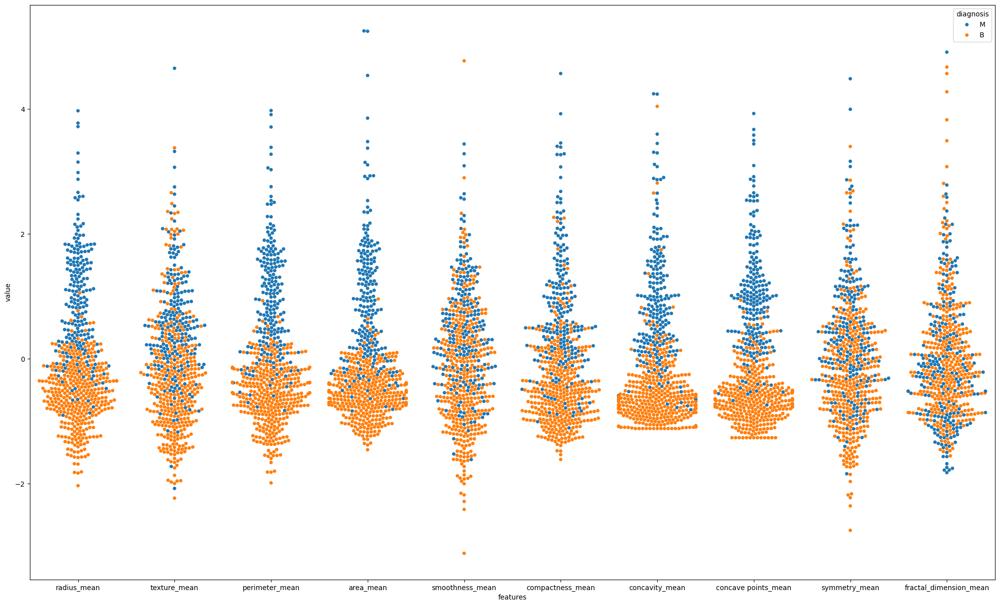

In [45]:
#Lets plot swarm plot_1
plt.figure(figsize=(25,15))
sns.swarmplot(x="features", y = "value", hue = "diagnosis", data = swarm_1_melt)

<Axes: xlabel='features', ylabel='value'>

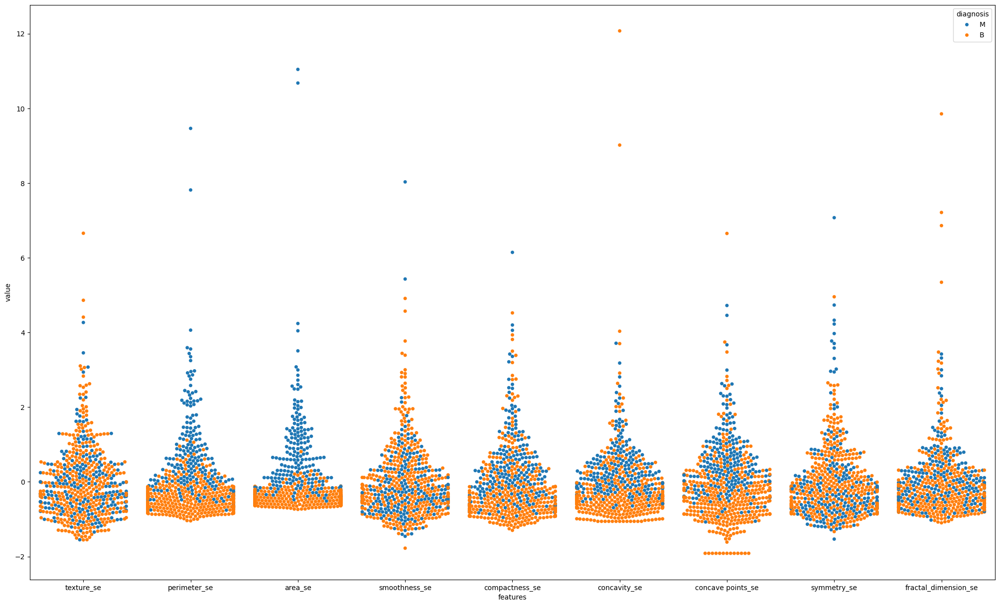

In [46]:
#Lets plot swarm plot_2
plt.figure(figsize=(25,15))
sns.swarmplot(x="features", y = "value", hue = "diagnosis", data = swarm_2_melt)

<Axes: xlabel='features', ylabel='value'>

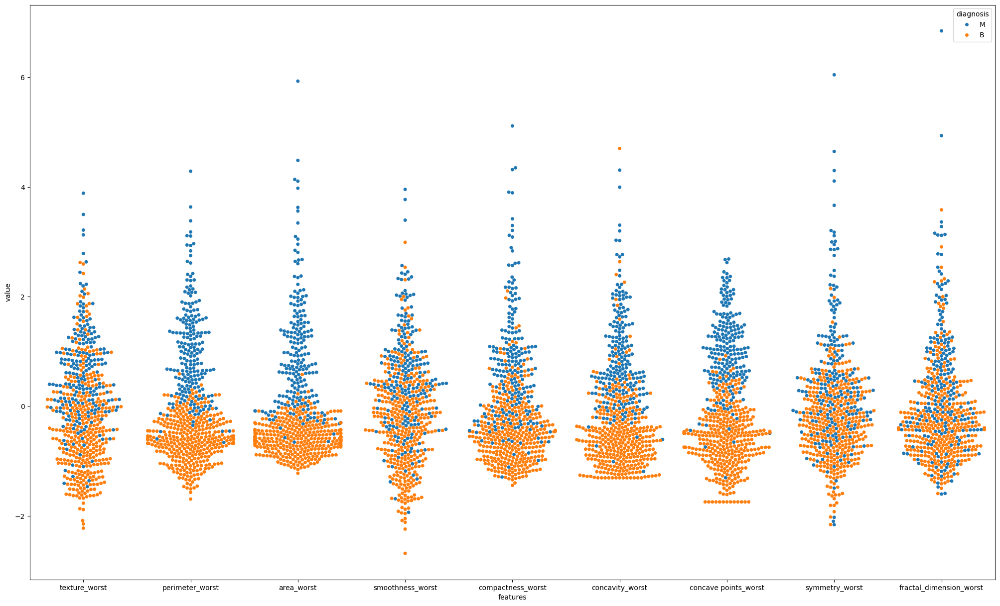

In [47]:
#Lets plot swarm plot_3
plt.figure(figsize=(25,15))
sns.swarmplot(x="features", y = "value", hue = "diagnosis", data = swarm_3_melt)

in the above swarm plots we can see variance clearly. We can make inferences similar to our previous violin plots but there will be a lot of work involved to analyze features one by one lookng at these plots. also, accuracy will be an issue. So Lets have a look at the correlations among all the features. for this we can make a heat map.

<Axes: >

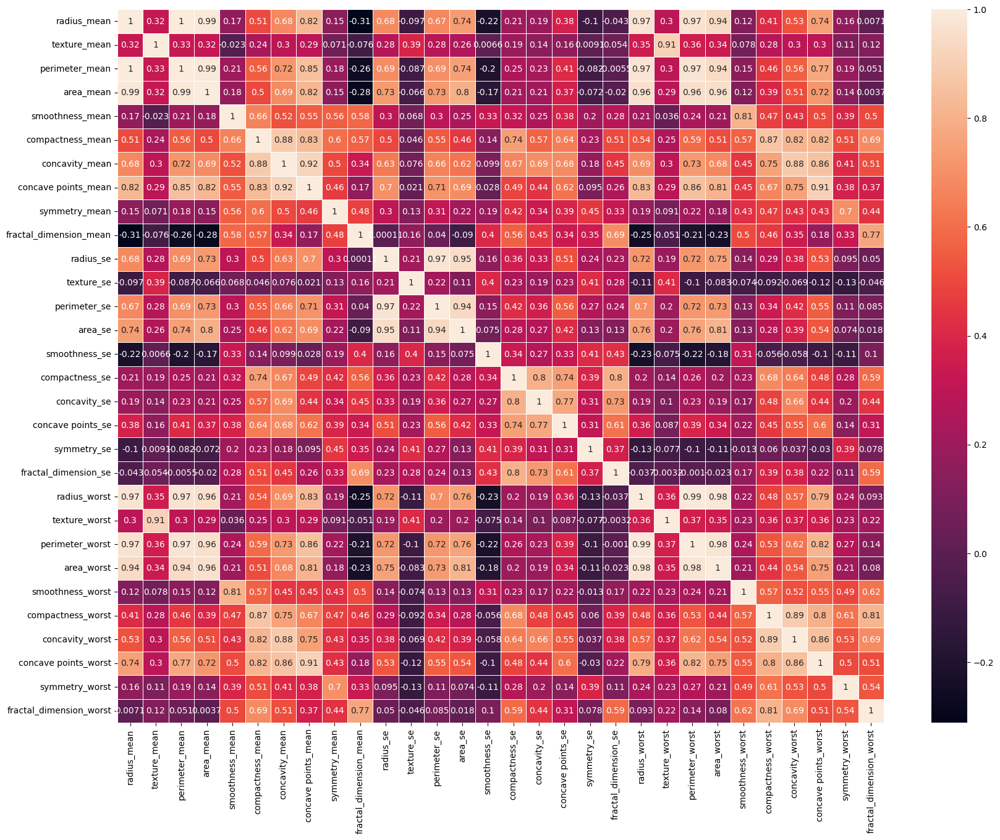

In [48]:
plt.figure(figsize=(20,15))
sns.heatmap(x_scaled_df.corr(), annot=True, linewidths=.5)

in the above heat map, radius_mean, area_mean, and perimeter_mean are highly correlated with each other. The correlation is 1 or 0.99. also, radius worst and perimeter worst are highly correlated with 0.97. so out of the first 3 we can choose only 1 and out of the last 2 we can choose only 1. Lets consider area_mean.  But there is no right answer to define why we choose area_mean. To understand these three features better and to check which one of them is a good candidate to be included in our model, we need to perform further analysis. So lets find other correlated features and check accuracy with a random forest classifier.

Here is a list of features that are selected for a random forest model just looking at the above heat map:  

radius_mean,area_mean,perimeter_mean - **area_mean**  
compactness_mean,concavity_mean,concave points_mean - **concavity_mean**    
radius_se, perimeter_se,area_se - **area_se**  
radius_worst,perimeter_worst,area_worst - **area_worst**  
compactness_worst,concavity_worst,concave points_worst - **concavity_worst**  
compactness_se,concavity_se,concave points_se - **concavity_se**  
texture_mean,texture_worst - **texture_mean**  

we can also drop **area_worst** beacuse it has high corelation with area_mean  

so we can drop the following columns   

['perimeter_mean','radius_mean','compactness_mean','concave points_mean','radius_se','perimeter_se','radius_worst','perimeter_worst','compactness_worst','concave points_worst','compactness_se','concave points_se','texture_worst']  

And we will keep the following features for our model.  

'symmetry_mean', 'fractal_dimension_mean','texture_se','smoothness_se','symmetry_se', 'fractal_dimension_se','smoothness_worst','symmetry_worst', 'fractal_dimension_worst', and 'smoothness_mean'

In [53]:
drop_list_1 = ['perimeter_mean','radius_mean','compactness_mean','concave points_mean','radius_se','perimeter_se','area_worst','radius_worst','perimeter_worst','compactness_worst','concave points_worst','compactness_se','concave points_se','texture_worst']

In [54]:
x_1=x_scaled_df.drop(drop_list_1,axis =1)
x_1.head()

,texture_mean,area_mean,smoothness_mean,concavity_mean,symmetry_mean,fractal_dimension_mean,texture_se,area_se,smoothness_se,concavity_se,symmetry_se,fractal_dimension_se,smoothness_worst,concavity_worst,symmetry_worst,fractal_dimension_worst
0,-2.073335,0.984375,1.568466,2.652874,2.217515,2.255747,-0.565265,2.487578,-0.214002,0.724026,1.148757,0.907083,1.307686,2.109526,2.750622,1.937015
1,-0.353632,1.908708,-0.826962,-0.023846,0.001392,-0.868652,-0.876244,0.742402,-0.605351,-0.440780,-0.805450,-0.099444,-0.375612,-0.146749,-0.243890,0.281190
2,0.456187,1.558884,0.942210,1.363478,0.939685,-0.398008,-0.780083,1.181336,-0.297005,0.213076,0.237036,0.293559,0.527407,0.854974,1.152255,0.201391
3,0.253732,-0.764464,3.283553,1.915897,2.867383,4.910919,-0.110409,-0.288378,0.689702,0.819518,4.732680,2.047511,3.394275,1.989588,6.046041,4.935010
4,-1.151816,1.826229,0.280372,1.371011,-0.009560,-0.562450,-0.790244,1.190357,1.483067,0.828471,-0.361092,0.499328,0.220556,0.613179,-0.868353,-0.397100


<Axes: >

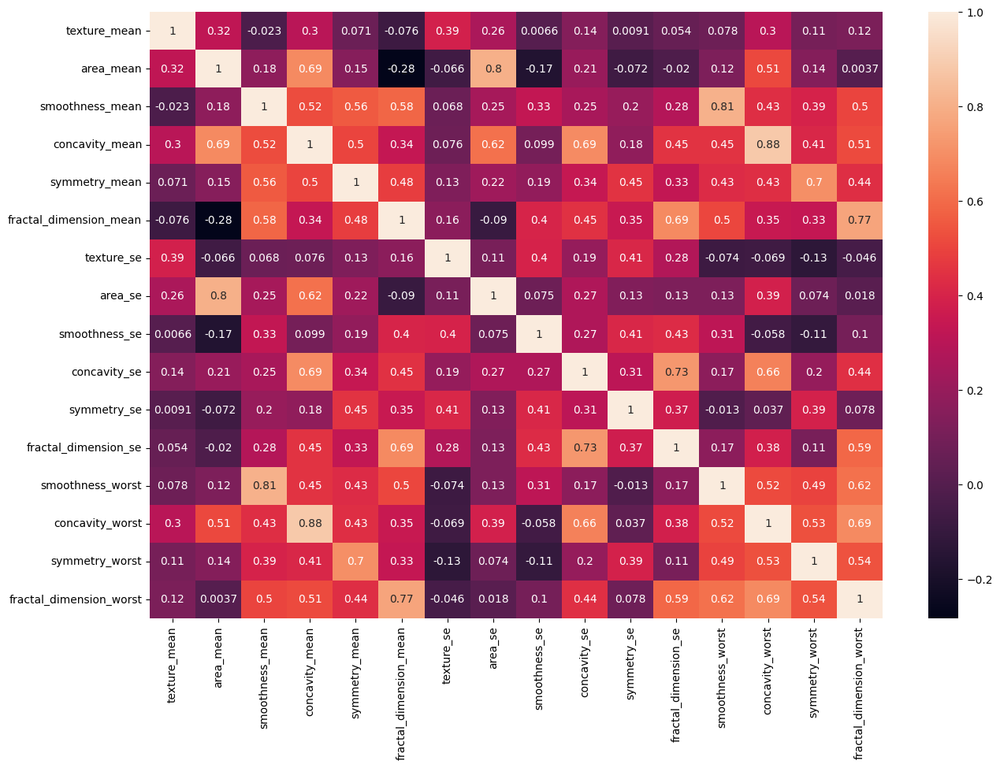

In [58]:
# Now lets check the correlation again using a heat map

plt.figure(figsize=(15,10))
sns.heatmap(x_1.corr(), annot = True)

In the above heat map we can see that there is high correlation between **smoothnes_mean** vs **smoothness_worst** and **concavity_mean**  vs **concavity_worst**. but the correaltions are in the 80s .A general acceptable range for multi-colinearity is 0.3 to 0.7 and our value is little more than this range. But are these features really important for our model. We can understand this better by running a random forest model.

In [60]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score,confusion_matrix
from sklearn.metrics import accuracy_score

In [61]:
# split data train 70 % and test 30 %
x_train, x_test, y_train, y_test = train_test_split(x_1, y_new, test_size=0.3, random_state=42)

In [65]:
#random forest classifier with N estimators = 10 (default)
clf = RandomForestClassifier(random_state=43)      
model_rf = clf.fit(x_train,y_train)

In [71]:
clf

RandomForestClassifier(random_state=43)

In [66]:
model_rf

RandomForestClassifier(random_state=43)

Accuracy is:  0.9649122807017544


<Axes: >

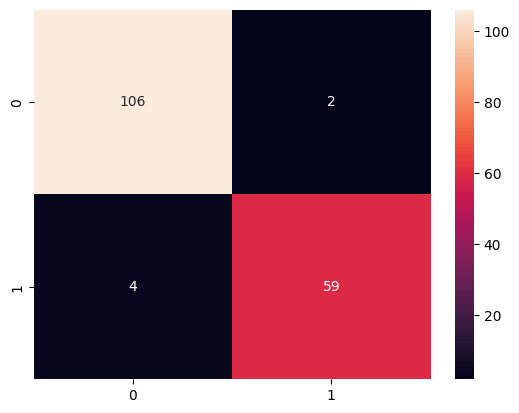

In [72]:
acc = accuracy_score(y_test,model_rf.predict(x_test))
print('Accuracy is: ',acc)
cm = confusion_matrix(y_test,model_rf.predict(x_test))
sns.heatmap(cm,annot=True,fmt="d")

The accuracy is almost 96.5 %. Lets try other feature selection methods. 


Lets try **k Best** and **RFE**.

In [77]:
#since our current df_std data has negative values and we cant use -ve values for a chi2 k best selection. Lets create anothe train text data set from the original x and y data

In [81]:
y.head()

0    M
1    M
2    M
3    M
4    M
Name: diagnosis, dtype: object

In [118]:
k_x_train, k_x_test, k_y_train, k_y_test = train_test_split(x_1, y_new, test_size=0.3, random_state=42)

In [119]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
# find best scored 5 features
select_feature = SelectKBest(chi2, k=5).fit(x_train, y_train)

ValueError: Input X must be non-negative.

In [101]:
k_y_train

149    B
124    B
421    B
195    B
545    B
      ..
71     B
106    B
270    B
435    M
102    B
Name: diagnosis, Length: 398, dtype: object

In [88]:
select_feature

SelectKBest(k=5, score_func=<function chi2 at 0x00000223834BD620>)

In [89]:
print('Score list:', select_feature.scores_)
feature_names = k_x_train.columns
# Get the boolean mask of selected features
selected_mask = select_feature.get_support()

# Get the selected feature names
selected_features = feature_names[selected_mask]

print("Selected features:", selected_features)

Score list: [1.77946492e+02 6.06916433e+01 1.34061092e+03 3.66899557e+04
 1.00015175e-01 3.41839493e+00 1.30547650e+01 7.09766457e+00
 1.95982847e-01 3.42575072e-04 2.45882967e+01 4.07131026e-02
 1.72696840e+02 6.12741067e+03 1.32470372e-03 3.74071521e-01
 6.92896719e-01 2.01587194e-01 1.39557806e-03 2.65927071e-03
 3.25782599e+02 1.16958562e+02 2.40512835e+03 7.50217341e+04
 2.63226314e-01 1.19077581e+01 2.58858117e+01 8.90751003e+00
 1.00635138e+00 1.23087347e-01]
Selected features: Index(['perimeter_mean', 'area_mean', 'area_se', 'perimeter_worst',
       'area_worst'],
      dtype='object')


In [104]:
#lets build a random forest classifier with these features

x_new = pd.DataFrame(x, columns = ['perimeter_mean', 'area_mean', 'area_se', 'perimeter_worst','area_worst'] )
x_new


,perimeter_mean,area_mean,area_se,perimeter_worst,area_worst
0,122.80,1001.0,153.40,184.60,2019.0
1,132.90,1326.0,74.08,158.80,1956.0
2,130.00,1203.0,94.03,152.50,1709.0
3,77.58,386.1,27.23,98.87,567.7
4,135.10,1297.0,94.44,152.20,1575.0
...,...,...,...,...,...
564,142.00,1479.0,158.70,166.10,2027.0
565,131.20,1261.0,99.04,155.00,1731.0
566,108.30,858.1,48.55,126.70,1124.0
567,140.10,1265.0,86.22,184.60,1821.0


In [105]:
x_train_2,x_test_2, y_train_2, y_test_2 = train_test_split(x_new, y, test_size=0.3, random_state=42)

Accuracy is:  0.9707602339181286


<Axes: >

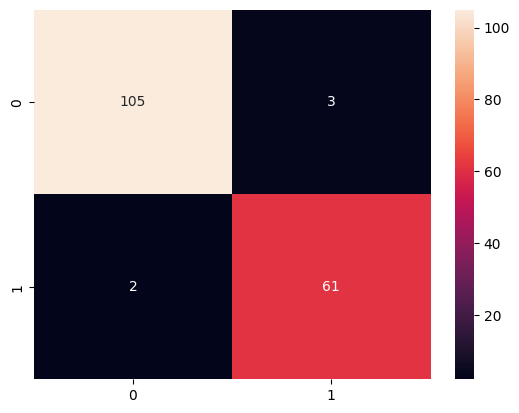

In [106]:
#random forest classifier with n_estimators=10 (default)
rf_2 = RandomForestClassifier()      
rf_2 = rf_2.fit(x_train_2,y_train_2)
ac_2 = accuracy_score(y_test_2,rf_2.predict(x_test_2))
print('Accuracy is: ',ac_2)
cm_2 = confusion_matrix(y_test_2, rf_2.predict(x_test_2))
sns.heatmap(cm_2,annot=True,fmt="d")

In [91]:
#Accuracy actually increased to 97%


In [115]:
#Lets try recurrsive feature elimination

from sklearn.feature_selection import RFE
# Create the RFE object and rank each pixel
rf_3 = RandomForestClassifier()      
rfe = RFE(estimator=rf_3, n_features_to_select=5, step=1)
rfe = rfe.fit(x, y)

In [116]:
rfe

RFE(estimator=RandomForestClassifier(), n_features_to_select=5)

In [117]:
# Assuming x_train_2 is a DataFrame with feature names
feature_names_2 = x.columns

# Get the boolean mask of selected features
selected_mask_2 = rfe.get_support()

# Get the selected feature names
selected_features_2 = feature_names_2[selected_mask_2]

print("Selected features:", selected_features_2)

Selected features: Index(['concave points_mean', 'radius_worst', 'perimeter_worst', 'area_worst',
       'concave points_worst'],
      dtype='object')


In [ ]:
# Select K best gave us these 5 features: ['perimeter_mean', 'area_mean', 'area_se', 'perimeter_worst','area_worst'] - But area Mean and Perimeter mean has high multi colinearity.
# RFE gave us these 5 features: ['concave points_mean', 'radius_worst', 'perimeter_worst', 'area_worst','concave points_worst'] - But radius worst and Perimeter worst has high multi colinearity

In [110]:
# RFE also suggest the same 5 features that we selected using K-best

Now Lets check if we can improve performance by using cross validation with random forest

In [111]:
from sklearn.feature_selection import RFECV

In [113]:
# In the below code step = 1, means one feature will be eliminated at each iteration
# we can also select step as a float between 0 and 1. In that case it will correspond to the percentage(rounded down) of features to be removed at each iteration. 
# for example step = 0.1 means 10% of the featutres will be eliminated.

In [112]:
rf_4 = RandomForestClassifier()
rfecv = RFECV(estimator=rf_4, step=1, cv = 5, scoring = 'accuracy')
rfecv = rfecv.fit(x_train_2, y_train_2)

In [114]:
x_train_2

,perimeter_mean,area_mean,area_se,perimeter_worst,area_worst
149,88.12,585.0,21.47,97.19,725.9
124,86.10,553.5,14.66,91.99,632.1
421,98.22,656.1,49.45,114.10,809.2
195,82.53,516.4,15.75,90.81,600.6
545,87.19,573.2,31.24,97.58,729.8
...,...,...,...,...,...
71,58.79,244.0,25.44,62.56,284.4
106,75.17,412.5,20.62,85.51,521.7
270,90.30,632.6,10.77,94.44,684.6
435,91.12,599.5,18.85,113.90,869.3


In [ ]:
# There was some mistake in handling the data sets and it got confusing. So further analysis will be performed in a different note book. 
# These analysis will be performed: 
                        # Recursive feature elimination with cross validation and Random forest classification
                        # Tree Based Feature Selection and Random Forest Classification.
                        # Feature extraction with PCA 